# Assignment 1 - Image Classification

This notebook contains the required task for the first assignment of the Deep Network Development course. Read the task description and implement the empty code cells. Each section represents a stage along implementing an image classifier, from loading and inspecting the dataset to training a **pre-trained** Convolutional Neural Network architecture. The sections are to guide you but you do not have to follow that specific order. 

Copy this notebook to your drive (File -> Save a copy in Drive), edit it and upload the final ipynb file to [Canvas](https://canvas.elte.hu) or upload the link to the Colab notebook itself. If you have your own machine with Jupyter installed, you can work there as well.

**Note** Make sure the notebook is using GPU accelerataion in Edit -> Notebook settings, otherwise training and evaluation can be very slow.

## Rules and Comments
- From the list of datasets and architectures listed in canvas, each student was atributed **1 dataset and 1 architecture** to use within this assignment. Please confirm yours in the Canvas assignment's description. 
- This is an DL class so to pass the homework you do have to implement a working classifier, just loading the data or having a "random-guess" performance is not enough.
- As always, copying others' code will make you fail the homework automatically (and thus the course). 
- **Deadline is October 19**
- Make sure your code can be run from an empty state (use Runtime -> Run all in the menu after restarting the notebook)
- Feel free to add more code cells as needed. But don't put code into external Python files to ease the reviewing.
- Please add your name and Neptun ID below for easier identification.

**Name: Tala Petro**   
**Neptun ID: k1dl90** 

## Task description
Your task is to train an already pretrained Convolutional Neural Network architecture on a dataset, both given in canvas. The datasets contain images as input and class labels as target, thus you have to solve a Supervised Machine Learning Classification problem. 

The dataset shoud be divided into train, validation and test set, for which results should be presented for all.

You can either train the architecture you were given without changing its layers, or you can add more layers, if you believe it increases the accuracy. There is no expected percentage of accuracy, but **your accuracy should be better than random guessing and your loss has to decrease throughout the epochs**. We expect you to show visualisations (any of the following: matplotlib, seaborn, tensorboard, ...) of the accuracy and loss and use Early stopping while training your network.



## 0. Import libraries
Import all libraries/packages that you believe will help you fulfil the task, but **for the network only PyTorch can be used.**

In [1]:
import pandas as pd
import numpy as np
import tarfile
import cv2 as cv
import itertools
import matplotlib.pyplot as plt
import warnings
from PIL import Image, ImageFile
from sklearn.metrics import confusion_matrix
from itertools import compress

import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torch.nn.functional as F
import torchvision
from torch.utils.tensorboard import SummaryWriter
from torchvision.datasets.utils import download_url
from torchvision import transforms

warnings.simplefilter(action='ignore')
ImageFile.LOAD_TRUNCATED_IMAGES=True

## 1. Dataset 
Load the dataset you were given. Images should be stored in an X variable and your labels in a Y variable. Split your dataset into train, validation and test set and pre-process your data for training.

#### Loading the dataset
Show some images and labels of your dataset

In [2]:
dataset_url = "https://s3.amazonaws.com/fast-ai-imageclas/imagenette-320.tgz"
download_url(dataset_url, '.')

with tarfile.open('./imagenette-320.tgz', 'r:gz') as tar:
    tar.extractall(path='./data')

  0%|          | 0/341289752 [00:00<?, ?it/s]

In [3]:
def check_img(path):
    try:
        im = Image.open(path)
        return True
    except:
        return False
img_transforms = transforms.Compose([
    transforms.Resize((150, 150)),    
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465], std=[0.2023, 0.1994, 0.2010])]) 

In [4]:
# Load datasets
train_data = torchvision.datasets.ImageFolder(root='./data/imagenette-320/train', transform=img_transforms, is_valid_file=check_img)

val_data = torchvision.datasets.ImageFolder(root='./data/imagenette-320/val', transform=img_transforms, is_valid_file=check_img)

#### Splitting the dataset

In [5]:
train_size = int(len(train_data)*0.7)
test_size = len(train_data) - train_size
train_set, test_set = torch.utils.data.random_split(train_data, [train_size, test_size])

#### Pre-processing the dataset

In [6]:
# Creating Data loaders
batch_size = 24
train_data_loader = torch.utils.data.DataLoader(train_set, batch_size=batch_size)
val_data_loader  = torch.utils.data.DataLoader(val_data, batch_size=batch_size) 
test_data_loader  = torch.utils.data.DataLoader(test_set, batch_size=batch_size) 

In [7]:
if torch.cuda.is_available():
    device = torch.device("cuda") 
else:
    device = torch.device("cpu")

**Display Batch**

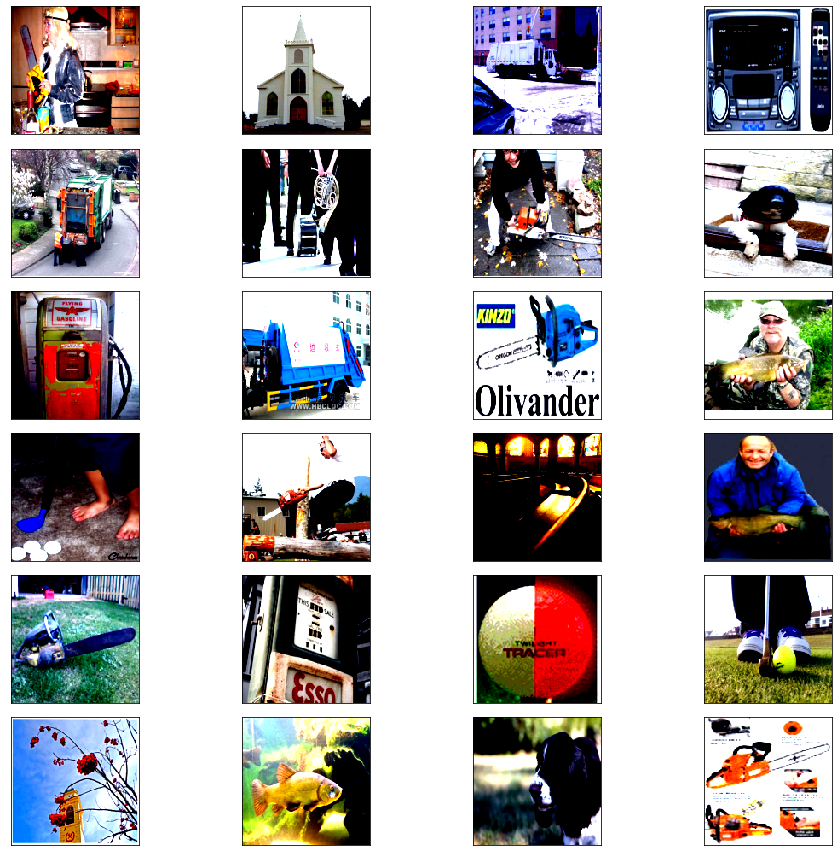

In [8]:
def display_img(img, show=True):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)),interpolation='none')
    if show:
        plt.show()



# Show images in a grid
def img_grid(image):
    plt.figure(figsize=(14,12))
    for i in range(0,24):
        plt.subplot(6,4,i+1)
        grid_data = image[i]
        display_img(grid_data, show=False)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()

#show some images from train set
image, label = next(iter(train_data_loader))
img_grid(image)

## 2. Convolutional Neural Network Architecture
Load the CNN architecture you were given using pretrained weights. Define the optimizer and loss function. Train your network and save it. Remember to use Early stopping and show results.

#### Load the architecture

In [9]:
model = torchvision.models.resnet18(pretrained=True)
num_ftrs = model.fc.in_features
#change outputs
model.fc = nn.Linear(num_ftrs, 10)

if torch.cuda.is_available():
    model.to('cuda')
model

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

#### Define your optimizer and loss function

In [10]:
# Freeze conv layers
for param in model.parameters():
    param.requires_grad = False

model.fc = nn.Linear(num_ftrs, 10)
model = model.to(device)

# Create list of params to learn
params_to_learn = []
for name,param in model.named_parameters():
    if param.requires_grad == True:
        params_to_learn.append(param)

In [11]:
optimizer = optim.SGD(params_to_learn, lr=0.0001, momentum=0.9)
loss_fn = torch.nn.CrossEntropyLoss()

#### Train your network

In [12]:
!rm -rf runs
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [13]:
def train(resnet18, train_loader, val_loader, optimizer, num_epochs, criterion):

    best_model = resnet18
    best_epoch = -1
    min_val_error = float('inf')
    error_going_up = 0
    writer = SummaryWriter()

    for epoch in range(num_epochs):
        # Training phase
        resnet18.train()
        train_loss = 0.0
        train_corrects = 0
        for idx, (inputs, labels) in enumerate(train_loader):
            optimizer.zero_grad()
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            output = resnet18(inputs)
            loss = criterion(output, labels)
            loss.backward()
            optimizer.step()

            _, preds = torch.max(output, 1)
            train_loss += loss.item() * inputs.size(0)
            train_corrects += torch.sum(preds == labels.data)

        train_loss = train_loss / len(train_loader.dataset)
        train_acc = train_corrects.double() / len(train_loader.dataset)
        

        writer.add_scalar('train/loss', train_loss, epoch)
        writer.add_scalar('train/acc', train_acc, epoch)

        # Validation phase 
        resnet18.eval()
        running_loss = 0.0
        running_corrects = 0
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            with torch.set_grad_enabled(False):
                output = resnet18(inputs)
                loss = criterion(output, labels)
                
                _, preds = torch.max(output, 1)
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                
        epoch_loss = running_loss / len(val_loader.dataset)
        epoch_acc = running_corrects.double() / len(val_loader.dataset)
        

        writer.add_scalar('val/loss', epoch_loss, epoch)
        writer.add_scalar('val/acc', epoch_acc, epoch)

        # Early stopping implementation
        if epoch_loss <= min_val_error:
            min_val_error = epoch_loss
            error_going_up = 0
            best_model = resnet18
            best_epoch = epoch
        else:
            error_going_up += 1
            if error_going_up == 5:
                print('Training terminated with early stopping on epoch: ' + str(epoch) + '. Best epoch:' + str(best_epoch))
                break 

        print('{}. Loss: {:.4f} Acc: {:.4f}'.format(epoch, epoch_loss, epoch_acc))

    writer.close()
    return best_model, best_epoch

In [14]:
best_model, best_epoch = train(model, train_data_loader, val_data_loader, optimizer, 30, loss_fn)

0. Loss: 0.7862 Acc: 0.8620
1. Loss: 0.5039 Acc: 0.9060
2. Loss: 0.4030 Acc: 0.9200
3. Loss: 0.3504 Acc: 0.9220
4. Loss: 0.3175 Acc: 0.9300
5. Loss: 0.2947 Acc: 0.9320
6. Loss: 0.2778 Acc: 0.9340
7. Loss: 0.2648 Acc: 0.9340
8. Loss: 0.2544 Acc: 0.9360
9. Loss: 0.2458 Acc: 0.9360
10. Loss: 0.2387 Acc: 0.9360
11. Loss: 0.2326 Acc: 0.9380
12. Loss: 0.2274 Acc: 0.9420
13. Loss: 0.2228 Acc: 0.9420
14. Loss: 0.2188 Acc: 0.9420
15. Loss: 0.2153 Acc: 0.9420
16. Loss: 0.2121 Acc: 0.9420
17. Loss: 0.2093 Acc: 0.9420
18. Loss: 0.2068 Acc: 0.9420
19. Loss: 0.2045 Acc: 0.9420
20. Loss: 0.2023 Acc: 0.9420
21. Loss: 0.2004 Acc: 0.9440
22. Loss: 0.1987 Acc: 0.9440
23. Loss: 0.1971 Acc: 0.9440
24. Loss: 0.1956 Acc: 0.9440
25. Loss: 0.1942 Acc: 0.9460
26. Loss: 0.1929 Acc: 0.9480
27. Loss: 0.1917 Acc: 0.9480
28. Loss: 0.1906 Acc: 0.9480
29. Loss: 0.1896 Acc: 0.9480


#### Show results (accuracy and loss) on training and validation sets

In [15]:
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 135), started 0:21:22 ago. (Use '!kill 135' to kill it.)

<IPython.core.display.Javascript object>

## 3. Conclusion (Evaluation)
Load your trained CNN and evaluate it on the test set. Show some predictions on the test set (3 is enough) by ploting the image and printing the prediction and ground truth.

How good are your results? Do you think the network is overfitted or underfitted? If yes, what do you think lead to that? If not, justify.

#### Evaluate your model

In [16]:
def test(model, loss_fn, test_loader, device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')):
    model.eval()
    num_correct = 0 
    num_examples = 0
    valid_loss = 0.0

    for batch in test_loader:
        inputs, targets = batch
        inputs = inputs.to(device)
        output = model(inputs)
        targets = targets.to(device)
        loss = loss_fn(output,targets) 
        valid_loss += loss.data.item() * inputs.size(0)
        correct = torch.eq(torch.max(F.softmax(output, dim=1), dim=1)[1],targets)
        num_correct += torch.sum(correct).item()
        num_examples += correct.shape[0]
        
    

    valid_loss /= len(test_loader.dataset)
    print('Test run:')
    print('Loss: {:.2f}, Accuracy = {:.2f}'.format(valid_loss, num_correct / num_examples))

#### Show some predictions

Showing test accuracy:

In [17]:
test(best_model, loss_fn, test_data_loader, device)

Test run:
Loss: 0.18, Accuracy = 0.94


In [18]:
labels = ['trench', 'English Springer', 'Casette player', 'Chainsaw', 'Church', 'French Horn', 'Garbage Truck', 'Gaspump', 'Golf ball', 'Parachute']


In [19]:
# Load predictions / labels / X_data / predicted probabilities into lists for further examination
y_pred, y_true, y_inst, y_prob = [], [], [], []

for batch in test_data_loader:
        inputs, targets = batch
        inputs = inputs.to(device)
        output = model(inputs)
        targets = targets.to(device)
        _, preds = torch.max(output, 1)
        y_prob.extend(output)
        y_inst.extend(inputs)
        y_pred.extend([labels[x] for x in preds])
        y_true.extend([labels[x] for x in targets])

In [28]:
def show_pred():
  w= next(iter(test_data_loader))
  batch = w
  ims, l = w
  inputs, targets = batch
  inputs = inputs.to(device)
  output = model(inputs)
  targets = targets.to(device)
  _, preds = torch.max(output, 1)
  plt.figure(figsize=(18,16))
  for i in range(0,24):
    plt.subplot(6,4,i+1)
    grid_data = ims[i]
    display_img(grid_data, show=False)
    plt.title('Pred: {}, Truth: {}'.format(y_pred[i],y_true[i]))
    plt.xticks([])
    plt.yticks([])
  plt.tight_layout()

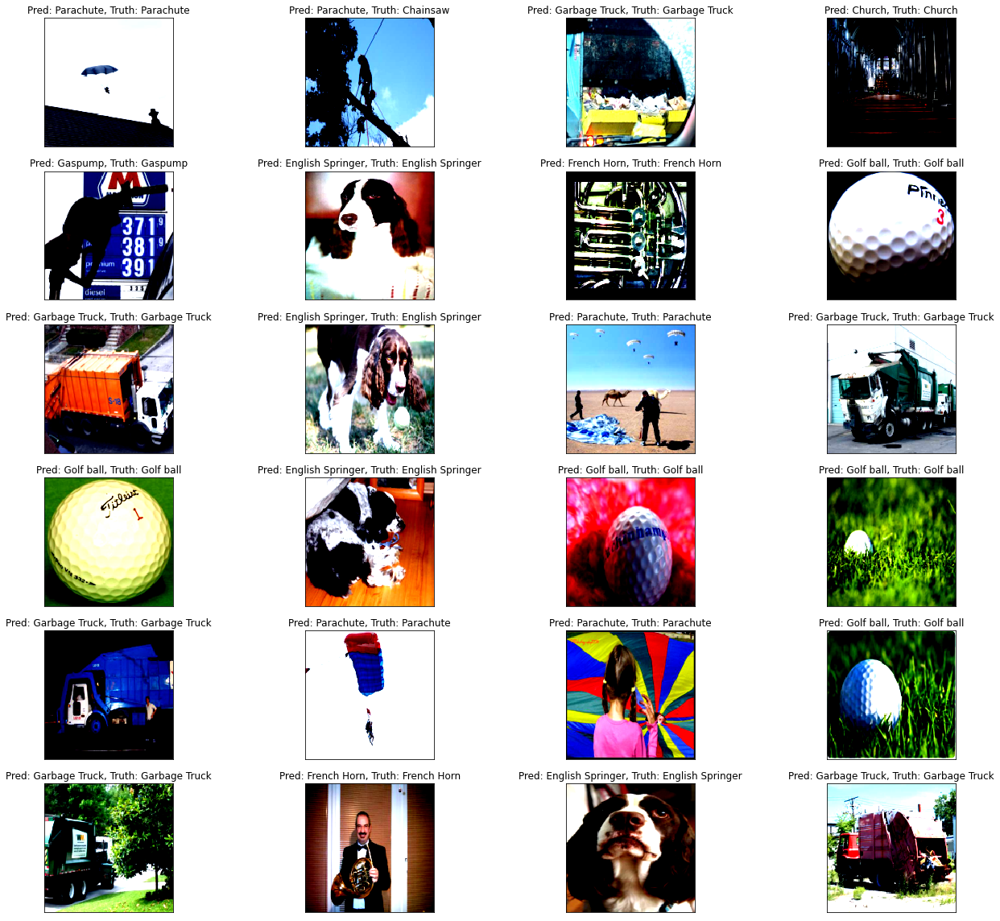

In [29]:
show_pred()

In [30]:
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion Matrix', cmap=plt.cm.Blues):
    plt.figure(figsize=(8,8))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
    thresh = cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i,j], horizontalalignment='center',
                 color='white' if cm[i, j] > thresh else 'black')
        
    plt.tight_layout()
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')

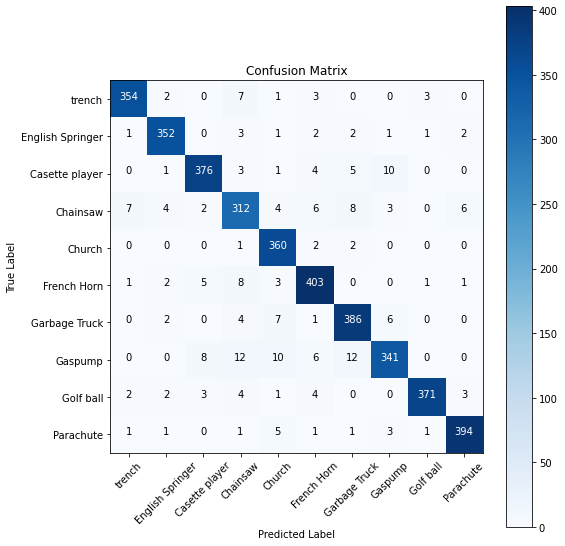

In [31]:
confusion_mtx = confusion_matrix(y_true, y_pred, labels=labels) 
plot_confusion_matrix(confusion_mtx, classes = labels) 

From the matrix above, we can see that the most mispredicted class is Chainsaw.

#### Answer the questions

I don't think the model is underfitted, nor overfitted. I have added a snippet of code to avoid overfitting. For the model to be overfitted, it would show high accuracy on the training set, but it would not perform well on the test set. But the results show accuracy of around 95% on the train set, and a 94% accuracy on the test set. 
For the model to be underfitted, it would have to show low accuracy on the training set, but the results show otherwise.
I am a little suspicous of how well the model is performing on the train and test set, but I cannot figure out why.